#A. Pendleton
#2017-09-20
#This script takes input vcf files, formats them for XP-CLR input, and then executes XP-CLR
#using simulated SNP datasets generated by ms-prime (by Jeff)

In [1]:
#this uses iPython magic to make plots appear inline
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import subprocess
import sys
import numpy as np
import matplotlib.patches as patches
import gzip
import fileinput
import glob

def count_lines(f):
    lineCount = 0
    with open(f, 'r') as f:
        for line in f:
            lineCount += 1
        return lineCount
def runCMD(cmd):
    val = subprocess.Popen(cmd, shell=True).wait()
    if val == 0:
        pass
    else:
        print ('command failed')
        print (cmd)
        sys.exit(1)

In [2]:
#Making list of chromosomes to process
chromToDo = []
for i in range(1,39):
    chrom = 'chr' + str(i)
    chromToDo.append(chrom)

In [3]:
#Reading in chromosome sizes to determine boundaries of sliding windows per chromosome
chromSizefile = '/home/ampend/links/kidd-lab/www-mirror/www/track-hub/canFam3/canFam3.1-browser-chrom-sizes.fai'
print ('Reading in chromosome lengths from: ', chromSizefile)
chromSizeFile = open(chromSizefile, 'r')

chromSizeList, chromlist = {}, []
#I also need a list of chr and position for finding the index for windows 
for line in chromSizeFile:
    if "chrM" in line or "chrUn" in line or "chrX" in line: #ignore mito
        continue
    line = line.rstrip().split()

    chromID,chromLength = line[0],int(line[1]) #chromosome ID and length
    chromlist.append(chromID)
    chromSizeList[chromID] = chromLength

Reading in chromosome lengths from:  /home/ampend/links/kidd-lab/www-mirror/www/track-hub/canFam3/canFam3.1-browser-chrom-sizes.fai


In [1]:
########################################################################################################################

In [1]:
########################################################################################################################

In [4]:
#working directory for the XP-CLR data
wkDir = '/home/ampend/links/kidd-lab/ampend-projects/Angela/Simulations/XP-CLR/'

samples = ['wolves','dogs']
#In/Out files
subDir = 'Dogs_v_Wolves' #subDir = 'Wolves_v_Dogs'
gridType = '50kbWindow_2kbGrid'
simulationRound = '10pop_v2_map'

resultsDir = wkDir + 'results/' + 'simulation' + simulationRound + '/' + gridType + '/' + subDir + '/' 
print(resultsDir)
print('\n### %s ####\n' % subDir)

/home/ampend/links/kidd-lab/ampend-projects/Angela/Simulations/XP-CLR/results/simulation10pop_v2_map/50kbWindow_2kbGrid/Dogs_v_Wolves/

### Dogs_v_Wolves ####



In [44]:
#Get the random 75 simulation files that were processed for this dataSet 
#   per chromosome and save them to a filedictionary so that we only use these chrom-simulation pairs
#   for all analyses going forward.
fileDict = {}

for chrom in range(1,39): #all chrom
    fileDict['chr'+str(chrom)] = []
    for file in glob.glob(resultsDir + 'thinned*chr%s_*txt' % (chrom)):
        fileName = file.replace(resultsDir,'')
        file = fileName.split('_')
        chrom = file[1]
        simNum = file[2].replace('simulation','')
        fileDict[chrom].append(simNum)
for each in fileDict: ##This is a check to make sure that we have the proper number of simulations going into XP-CLR
    maxCount = len(fileDict[each])
    if len(fileDict[each]) < 75:
        print(each)

In [57]:
#Merging files into one
for index in range(0,maxCount):
    command = 'cat '
    for chrom in fileDict.keys():
        simNum = fileDict[chrom][index]
        fileName = resultsDir + 'thinned_%s_simulation%s_%s_%s.xpclr.txt' % (chrom,simNum,gridType,subDir)
        command = command + fileName + ' '
    command = command + '> ' + resultsDir + 'Merged_%i_thinned.xpclr.txt' % (index)
    runCMD(command)

#########################################################################################
# This section is calculating the XP-CLR value averages based on a 
# 25kb sliding window (10kb steps). This is where the window significance
# is determined
#########################################################################################

In [5]:
def read_xpclr_file(inFile):
    #For keeping track of data
    totalData, chroms = {}, []
    scores, passCount = [], 0
    totalGrids,infCounts,failed_SNPZero,failed_SNPMin = 0, 0, 0, 0

    for line in inFile:
        line=line.rstrip().split(' ')
        if 'chrom' in line[0]:#skips header
            continue
        chrom = 'chr' + line[0]
        if chrom not in chroms:
            chroms.append(chrom)
            totalData[chrom] = []
        #processing line for more data
        gridNum, snpCount = int(line[1]),int(line[2])
        physical_pos,genetic_pos,max_s = round(float(line[3])),float(line[4]),float(line[6])
        XPCLR_score = line[5]
        totalGrids+=1
        #keeping track of certain data points
        if 'inf' in XPCLR_score:
            infCounts+=1
            continue
        if snpCount < 1:
            failed_SNPZero += 1
            continue
        if snpCount < 5:
            failed_SNPMin += 1
            continue
        XPCLR_score=float(line[5])
        scores.append(XPCLR_score)
        totalData[chrom].append([chrom,gridNum,snpCount,physical_pos,genetic_pos,XPCLR_score,max_s])
        passCount += 1
        #Writing this information to a bedfile
        #bedFile.write('%s\t%s\t%s\t%s_%s\n' % (chrom,physical_pos-1,physical_pos,chrom,passCount))
    inFile.close()
    ################################################################
    print('%s grids were processed by XP-CLR' % ((totalGrids)))
    print('##EXCLUSIONS')
    print('%s of the grids had scores equal to infinity and were excluded until we determine what that means (failure??)' % infCounts)
    print('%s of the grids had no SNPs and were removed' % failed_SNPZero)
    print('%s of the grids had fewer than 5 SNPs and were removed' % failed_SNPMin)
    print('##FOR PROCESSING')
    print('%s of the grids remained for further processing after passing filtrations' % passCount)
    
    return totalData
#########################################################################################

In [6]:
###PARAMETERS###
stepSize = int(10000)
windowSize = int(25000)
short_windowSize = str(int(float(windowSize)/1000)) #for file naming


In [76]:
def calculate_slidingwindow_XPCLR(chromSizeList,chr_pos):
    ###PARAMETERS###
    stepSize = int(10000)
    windowSize = int(25000)
    short_windowSize = str(int(float(windowSize)/1000)) #for file naming

    #Generating the sliding window coordinates
    head_idx, tail_idx, last_line = 0, 0, 0
    sliding_window_coord_dict = {}
    sliding_window_averages = {}

    for chrom in range(1,39):
        chrom = 'chr' + str(chrom)
        sliding_window_coord_dict[chrom] = []
        window_start, window_end, totalWindowCount, lastWindow  = 0, 0, 0, False
        for i in range(1,130000000,stepSize):
        #for i in range(1,130000000,10000):  #sliding windows along each chromosome with a 10kb step size
            if i > 1 and window_end ==  int(chromSizeList[chrom]):
                break
            #****NOTE: change here if you're wanting to alter the window size (window_end=i+N-1) where N = sliding window size
            window_start = i
            #window_end = i + 50000 - 1
            window_end = i + windowSize - 1

            if int(window_start) > int(chromSizeList[chrom]):
                break
            if int(window_end) > int(chromSizeList[chrom]): #if the end of the window extends further than the length of the chromsome, then the window end is the length of the chromosome
                window_end = int(chromSizeList[chrom])

            while int(chr_pos[head_idx][1]) < i and chr_pos[head_idx][0] == chrom:
                head_idx += 1
            if head_idx >= len(chr_pos): #if head index is greater than the total number of SNPs, cancel
                break
            if tail_idx >= len(chr_pos):#if head index is greater than the total number of SNPs, cancel
                break
            #****NOTE: change here if you're wanting to alter the window size (i+N) where N = sliding window size
            while (int(chr_pos[tail_idx][1]) <= (i+windowSize) and chr_pos[tail_idx][0] == chrom):
                tail_idx += 1
                if tail_idx == len(chr_pos): 
                    last_line = 1
                    break
            ##################
            windowScores = []
            for p in range(0,len(totalData[chrom])):
                pos_chrom,pos_pos,pos_score = totalData[chrom][p][0],int(totalData[chrom][p][3]), float(totalData[chrom][p][5])
                if pos_chrom != chrom:
                    continue
                if pos_pos >= window_start and pos_pos <= window_end:
                    windowScores.append(pos_score)
                if pos_pos > window_end:
                    break
            if len(windowScores) > 0:
                avg_score, median_score = round(np.mean(windowScores),3), round(np.median(windowScores),3)     
            else:
                avg_score, median_score = 'na', 'na'
            sliding_window_coord_dict[chrom].append([chrom,window_start,window_end,len(windowScores),avg_score,median_score])
        print('Done with chromosome %s with size %i bp' % (chrom, chromSizeList[chrom]))
    
    return sliding_window_coord_dict

In [77]:
def write_averages_to_file(outFile,sliding_window_coord_dict):
    #Writing window averages to outfile
    count = 0
    outFile.write('Chromosome\tWindow_Start\tWindow_End\tNumber_of_XP-CLR_Regions\tAverage_XP-CLR_Score\tMedian_XP-CLR_Score\n')
    for i in sliding_window_coord_dict:
        chrom = i
        count = count + len(sliding_window_coord_dict[chrom])
        for window in range(0,len(sliding_window_coord_dict[chrom])):
            outFile.write('\t'.join(map(str,sliding_window_coord_dict[chrom][window])) + '\n')
    outFile.close()
    #How many windows are spanning the genome?
    print('%i sliding window coordinates are found' % count)

In [78]:
for index in range(0,maxCount):
    print('Processing file #%i' % (index))
    chr_pos = []
    posFile = open(resultsDir + 'Merged_%s_thinned.xpclr.txt' % (index), 'r')    
    totalData = read_xpclr_file(posFile)
    for chrom in totalData:
        for i in range(0,len(totalData[chrom])):
            chrom,pos = totalData[chrom][i][0],totalData[chrom][i][3]
            chr_pos.append([chrom, pos])
    posFile.close()

    #Go to calculate sliding window XP-CLR average scores
    sliding_window_coord_dict = calculate_slidingwindow_XPCLR(chromSizeList,chr_pos)
    
    #Write out the XP-CLR averages to outfile
    outFile = open(resultsDir + '25kbSlidingWindowAverages_' + str(index) + '_' + subDir + '_XP-CLR_' + gridType + '.txt','w')
    write_averages_to_file(outFile,sliding_window_coord_dict)
    break

Processing file #0
1093538 grids were processed by XP-CLR
##EXCLUSIONS
932688 of the grids had scores equal to infinity and were excluded until we determine what that means (failure??)
11865 of the grids had no SNPs and were removed
54105 of the grids had fewer than 5 SNPs and were removed
##FOR PROCESSING
94880 of the grids remained for further processing after passing filtrations
Done with chromosome chr1 with size 122678785 bp
Done with chromosome chr2 with size 85426708 bp
Done with chromosome chr3 with size 91889043 bp
Done with chromosome chr4 with size 88276631 bp
Done with chromosome chr5 with size 88915250 bp
Done with chromosome chr6 with size 77573801 bp
Done with chromosome chr7 with size 80974532 bp
Done with chromosome chr8 with size 74330416 bp
Done with chromosome chr9 with size 61074082 bp
Done with chromosome chr10 with size 69331447 bp
Done with chromosome chr11 with size 74389097 bp
Done with chromosome chr12 with size 72498081 bp
Done with chromosome chr13 with siz

#########################################################################################
# This is where we filter the windows using various 
# requirements to consider something a true "sweep" or not.

# These steps require the input file from the above average 
# calculations. 
#########################################################################################

In [7]:
def slide_filter_windows(slideData):
    filteredWindows = []
    
    for i in range(0,len(slideData)):
        #MEAN XP-CLR SCORE BEING SAVED BELOW AS "SCORE"
        chrom, score, gridCount = slideData[i][0], round(float(slideData[i][4]),3), int(slideData[i][3])
        #Filter out windows that dont have at least 5 grids within them
        if gridCount < 5:
            continue
        filteredWindows.append(slideData[i])
    print('%i sliding windows remain with at least five grids found from XP-CLR'%(len(slideData)))
    return filteredWindows
##########################################################################################
def slide_basic_stats(filteredWindows):
    #Save as pandas dataframe
    print('#Calculating basic stats')
    df = pd.DataFrame(filteredWindows, columns=['Chromosome','Window_Start','Window_End','XP-CLR_Window_Count','Average_XP-CLR_Score','Median_XP-CLR_Score'])
    scoreMed = df['Average_XP-CLR_Score'].median()
    scoreMean = df['Average_XP-CLR_Score'].mean()
    scoreMax = df['Average_XP-CLR_Score'].max()
    print ('Median XP-CLR Score is', scoreMed)
    print ('Mean XP-CLR Score is ', scoreMean)
    print ('Max XP-CLR Score is ', scoreMax)

    pct99, pct995, pct999 = np.percentile(df['Average_XP-CLR_Score'], 99), np.percentile(df['Average_XP-CLR_Score'], 99.5), np.percentile(df['Average_XP-CLR_Score'], 99.9)
    print('##SIGNIFICANCE CUT-OFFS\n99th percentile of XP-CLR scores == ', pct99)
    print('99.5th percentile of XP-CLR scores == ', pct995)
    print('99.9th percentile of XP-CLR scores == ', pct999)
    
    return df, pct99,pct995,pct999
##########################################################################################
def slide_find_sig_windows(sigThreshold, filteredWindows):
    print('\n#SIGNIFICANT WINDOWS\nSignificance threshold is XP-CLR = ', sigThreshold)
    sigHits = []
    
    for i in range(0,len(filteredWindows)):
        #MEAN XP-CLR SCORE BEING SAVED BELOW AS "SCORE"
        chrom, score, gridCount = filteredWindows[i][0], round(float(filteredWindows[i][4]),3), int(filteredWindows[i][3])
        if score > sigThreshold:
            sigHits.append(filteredWindows[i])
    print('%i significant windows found from XP-CLR'%(len(sigHits)))
    return sigHits
################################################################################################
def draw_slide_hist(df, plotFile, pct99,index):
    fig = plt.figure(figsize=(15, 5)) #Set up subplots for below distributions
    ax = fig.add_subplot(111)
    #Graph 1 = Score Distribution
    #MEAN
    df['Average_XP-CLR_Score'].plot(kind='hist', bins=350,xlim=(0,50),alpha=0.75, normed = True)
    #MEDIAN
    #df['Median_XP-CLR_Score'].plot(ax=axs[0],kind='hist', bins=350,xlim=(0,50),alpha=0.75, normed = True)

    ax.set_xlabel('Average XP-CLR Score')
    ax.set_title('All Chromosomes - XP-CLR Average Sliding Window Score Distribution\n Round %i' % index)
    ax.vlines(x=pct99,ymin=0,ymax=0.4, lw=1,color="red")

    #Graph 2 = SNP Count Distribution
    """df['XP-CLR_Window_Count'].plot(ax=axs[1],kind='hist', bins=20,alpha=0.75, normed = True, color="darkorange")
    ax = axs[1]
    ax.set_xlabel('XP-CLR Windows per Sliding Window')
    ax.set_title('All Chromosomes - Per Sliding Window XP-CLR Window Counts')
    avg_SNPCount = df['XP-CLR_Window_Count'].mean()
    ax.vlines(x=avg_SNPCount,ymin=0,ymax=0.1, lw=1,color="red")
    ax.set_xlim(0,25)
    plt.tight_layout()
    plt.savefig(plotFile) #Saving plots"""
################################################################################################
def slide_draw_Manhattan_Plot(slideData,plotFile,sigThreshold,index):
    df = pd.DataFrame(slideData, columns=['Chromosome','Window_Start','Window_End','XP-CLR_Window_Count','Average_XP-CLR_Score','Median_XP-CLR_Score'])
    df.Chromosome = df.Chromosome.astype('category')
    df.Chromosome = df.Chromosome.cat.set_categories(chromToDo, ordered=True)
    df = df.sort_values('Chromosome')

    df.head()
    # How to plot gene vs. -log10(pvalue) and colour it by chromosome?
    df['ind'] = range(len(df))
    df_grouped = df.groupby(('Chromosome'))

    ###PLOTTING MANHATTAN PLOT 
    #plotDir = '/home/ampend/links/kidd-lab/ampend-projects/Angela/XP-CLR/results/plots/'
    fig = plt.figure(figsize=(24,16))
    ax = fig.add_subplot(111)
    x_labels, x_labels_pos, colors = [], [], ['black','gray']
    for num, (name, group) in enumerate(df_grouped):
        group.plot(kind='scatter', x='ind', y='Average_XP-CLR_Score',color=colors[num % len(colors)], ax=ax)
        x_labels.append(name)
        x_labels_pos.append((group['ind'].iloc[-1] - (group['ind'].iloc[-1] - group['ind'].iloc[0])/2))
    #Xaxis
    ax.set_xlim([0, len(df)])
    ax.set_xticklabels(ax.xaxis.get_majorticklabels(), rotation=45)
    ax.set_xticks(x_labels_pos)
    ax.set_xticklabels(x_labels, fontsize=16)
    ax.set_xlabel('Chromosome',fontsize=20)
    #Yaxis
    ax.set_ylim([0, 100])
    ax.set_ylabel('Average XP-CLR Score',fontsize=20)
    #Tick label sizes
    plt.tick_params(axis='both', which='major', labelsize=16)
    fig.tight_layout(rect=[0,0,.8,1]) 
    plt.hlines(y=sigThreshold,xmin=0,xmax=len(df), lw=1,color="red", label="99.5th Sig Level")
    legend = ax.legend(loc='upper right', shadow=False,prop={'size': 20})
    plt.title(subDir.replace('_',' ') + ' XP-CLR Scores' + 'Round ' + str(index),fontsize=30)
    plt.tight_layout()
    plt.savefig(plotFile)
##############################################################################################################

In [8]:
def slide_merge_sig_windows(sigHits):
    sigCount = 0
    print('\n#MERGED WINDOWS')
    chromList, mergedWindows = [], {}
    for i in range(0,len(sigHits)):
        chrom, start, end, num, score = sigHits[i][0], int(sigHits[i][1]), int(sigHits[i][2]),int(sigHits[i][3]),float(sigHits[i][4])
        winID  = chrom + '_' + str(num)

        #NEW
        #if num < 5: #if less than 5 grids (2kb grid * 5 = 10kb sliding window )
        #    continue

        #keeping track of chromosomes analyzed, helps save information automatically for first call on a chromosome
        #   for further comparisons with the next call
        if chrom not in chromList:
            chromList.append(chrom)
            CHROM, NUM, START,END,SCORE = chrom, num, start, end, score
            sigCount += 1
            mergedWindows[sigCount] = []
            mergedWindows[sigCount].append([CHROM, NUM, START, END, SCORE])
            #print('FIRST ON CHROM',chrom, num, start, end, score) #CHECK
            continue

        #processing calls
        if CHROM == chrom and start - START < 100001: #can only have one window between them
            #print('NEXT',chrom, num, start, end, score) #CHECK
            CHROM, NUM, START,END,SCORE = chrom, num, start, end, score
            mergedWindows[sigCount].append([CHROM, NUM, START, END, SCORE])

        else:
            #print('NO',chrom, num, start, end, score) #CHECK
            sigCount += 1
            CHROM, NUM, START,END,SCORE = chrom, num, start, end, score
            mergedWindows[sigCount] = []
            mergedWindows[sigCount].append([CHROM, NUM, START, END, SCORE])

    print('%i merged windows found to be significant' % sigCount)
    return mergedWindows
##########################################################################################
def slide_filter_merged_windows(mergedWindows,index):
    print('\n#FILTER MERGED WINDOWS')
    merged3Windows, count = [], 0

    for i in mergedWindows:
        #if len(mergedWindows[i]) < 5:
        #    continue
        count += 1 #keeping track of how many merged windows with at least 3 sig windows are present
        chrom, start = mergedWindows[i][0][0], mergedWindows[i][0][2] #chrom and start can be defined by the first indexed window in the list
        scores = []
        for j in mergedWindows[i]:
            end = j[3] #end will always be the last window read through the loop, constantly overwriting
            scores.append(j[4]) #to keep track of for calculating the average score
        meanScore = format(round(np.mean(scores),3)) #formats and rounds the average scores per merged window
        winLength = end - start + 1
        winCount = len(mergedWindows[i])
        merged3Windows.append([chrom,start,end,winLength,meanScore,winCount]) #now save all the information

    #NOT ANYMORE:
    #print('%i windows contained three or more adjacent windows and were merged' % count) 

    outfile = resultsDir + '/SignificantWindows/' + 'Significant_%i_3Windows_pct99_AverageXP-CLRScore.txt' % (index)
    outFile = open(outfile, 'w')
    for i in range(0,len(merged3Windows)):
        outFile.write('\t'.join(map(str,merged3Windows[i]))+'\n')
    outFile.close()
    
    sortfile = outfile + '.sorted'
    cmd = 'sort -k1,1V -k2,2n %s > %s' % (outfile, sortfile)
    runCMD(cmd)
    
    #Naming the windows now based on the order determined from the sort above
    sortFile = open(sortfile,'r')
    count,merged3Windows = 0, []

    for line in sortFile:
        line=line.rstrip().split('\t')
        count+=1
        chrom,start,end,size,average,winCount = line[0],int(line[1]),int(line[2]),int(line[3]),float(line[4]),int(line[5])
        winID = 'XP-CLR_' + str(count)
        merged3Windows.append([chrom,start,end,winID,winCount,size,average])
    sortFile.close()
    
    #Over writing previous file
    outfile = resultsDir + '/SignificantWindows/' + 'Significant_%s_3Windows_pct99_AverageXP-CLRScore.txt' % (str(index))
    outFile = open(outfile, 'w')
    for i in range(0,len(merged3Windows)):
        outFile.write('\t'.join(map(str,merged3Windows[i]))+'\n')
    outFile.close()
    #deleting sorted original file so not to get confusing
    cmd = 'rm %s' % sortfile
    runCMD(cmd)
    
    return merged3Windows

Processing file #0
153982 sliding windows had no data and were therefore ignored...
66354 windows remain for analysis and determination of significance thresholds

66354 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score is 1.178
Mean XP-CLR Score is  2.8800644539007174
Max XP-CLR Score is  127.289
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  25.73876
99.5th percentile of XP-CLR scores ==  30.61468
99.9th percentile of XP-CLR scores ==  36.006712

#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  25.73876
177 significant windows found from XP-CLR

#MERGED WINDOWS
29 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #1
153746 sliding windows had no data and were therefore ignored...
66590 windows remain for analysis and determination of significance thresholds

66590 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score 

/sw/lsa/centos7/python-anaconda-arc-connect/created-20170421/lib/python3.5/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)



#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  16.4662
165 significant windows found from XP-CLR

#MERGED WINDOWS
72 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #11
153784 sliding windows had no data and were therefore ignored...
66552 windows remain for analysis and determination of significance thresholds

66552 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score is 1.379
Mean XP-CLR Score is  3.27540469172931
Max XP-CLR Score is  58.59
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  31.94852
99.5th percentile of XP-CLR scores ==  32.59316
99.9th percentile of XP-CLR scores ==  33.92064

#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  31.94852
167 significant windows found from XP-CLR

#MERGED WINDOWS
20 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #12
152884 sliding windows had no data and were therefore ignored...
67452 win


#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  18.55953
178 significant windows found from XP-CLR

#MERGED WINDOWS
58 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #23
154081 sliding windows had no data and were therefore ignored...
66255 windows remain for analysis and determination of significance thresholds

66255 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score is 1.394
Mean XP-CLR Score is  2.3785758206470087
Max XP-CLR Score is  75.124
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  14.00485
99.5th percentile of XP-CLR scores ==  18.3448
99.9th percentile of XP-CLR scores ==  40.073485

#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  14.00485
169 significant windows found from XP-CLR

#MERGED WINDOWS
83 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #24
153543 sliding windows had no data and were therefore ignored...
66793


#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  15.09928
161 significant windows found from XP-CLR

#MERGED WINDOWS
80 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #35
153586 sliding windows had no data and were therefore ignored...
66750 windows remain for analysis and determination of significance thresholds

66750 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score is 1.4545
Mean XP-CLR Score is  3.1758360551308655
Max XP-CLR Score is  88.711
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  25.5021
99.5th percentile of XP-CLR scores ==  28.44155
99.9th percentile of XP-CLR scores ==  35.302718

#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  25.5021
173 significant windows found from XP-CLR

#MERGED WINDOWS
40 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #36
153133 sliding windows had no data and were therefore ignored...
67203


#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  28.26552
172 significant windows found from XP-CLR

#MERGED WINDOWS
23 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #47
153842 sliding windows had no data and were therefore ignored...
66494 windows remain for analysis and determination of significance thresholds

66494 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score is 1.149
Mean XP-CLR Score is  2.0598831168831064
Max XP-CLR Score is  93.353
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  14.45335
99.5th percentile of XP-CLR scores ==  20.83017
99.9th percentile of XP-CLR scores ==  40.903783

#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  14.45335
171 significant windows found from XP-CLR

#MERGED WINDOWS
74 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #48
153313 sliding windows had no data and were therefore ignored...
6702


#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  16.55052
169 significant windows found from XP-CLR

#MERGED WINDOWS
71 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #59
153889 sliding windows had no data and were therefore ignored...
66447 windows remain for analysis and determination of significance thresholds

66447 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score is 1.147
Mean XP-CLR Score is  2.1227463975229246
Max XP-CLR Score is  112.149
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  14.75314
99.5th percentile of XP-CLR scores ==  18.835575
99.9th percentile of XP-CLR scores ==  40.972787

#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  14.75314
168 significant windows found from XP-CLR

#MERGED WINDOWS
81 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #60
155664 sliding windows had no data and were therefore ignored...
64


#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  19.845
177 significant windows found from XP-CLR

#MERGED WINDOWS
55 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #71
153072 sliding windows had no data and were therefore ignored...
67264 windows remain for analysis and determination of significance thresholds

67264 sliding windows remain with at least five grids found from XP-CLR
#Calculating basic stats
Median XP-CLR Score is 1.146
Mean XP-CLR Score is  2.2575938537255493
Max XP-CLR Score is  83.485
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  26.25924
99.5th percentile of XP-CLR scores ==  28.898145
99.9th percentile of XP-CLR scores ==  37.554112

#SIGNIFICANT WINDOWS
Significance threshold is XP-CLR =  26.25924
175 significant windows found from XP-CLR

#MERGED WINDOWS
22 merged windows found to be significant

#FILTER MERGED WINDOWS
Processing file #72
153264 sliding windows had no data and were therefore ignored...
67072

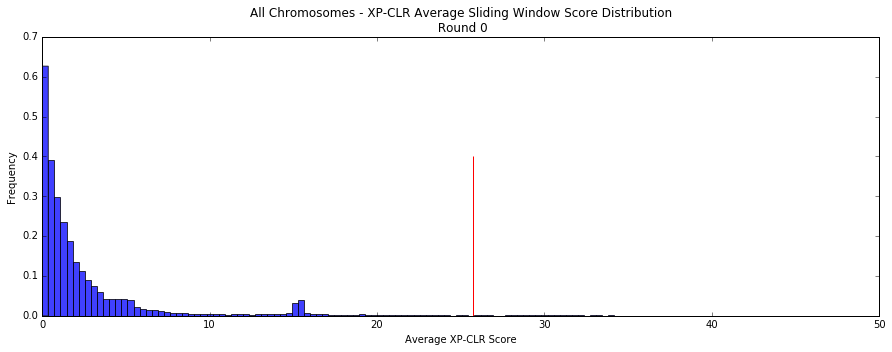

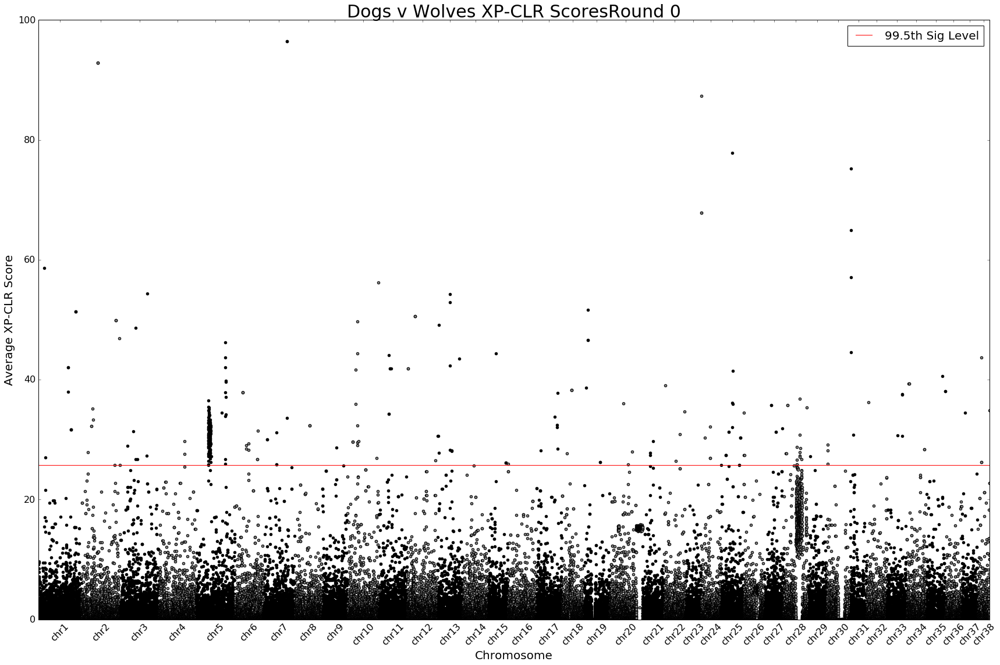

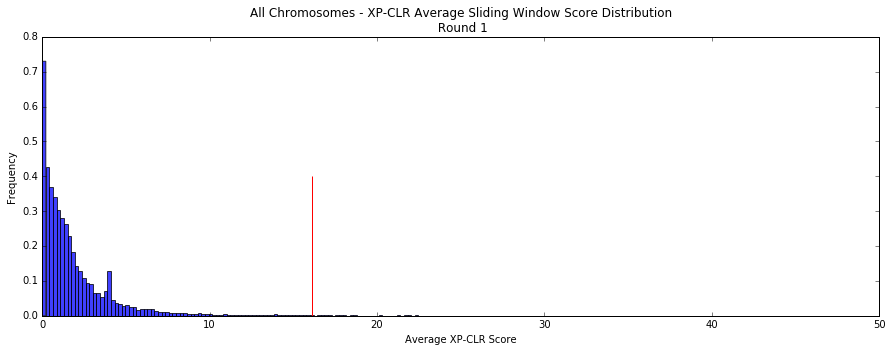

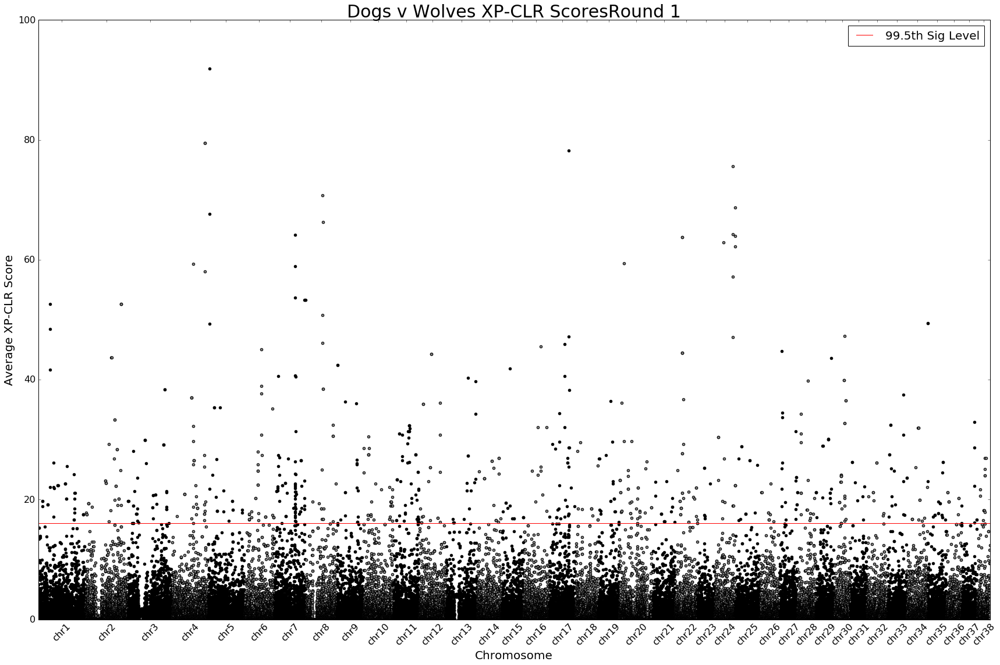

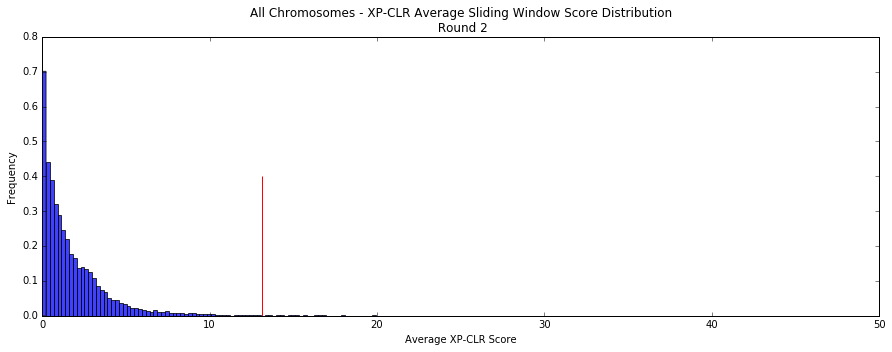

...

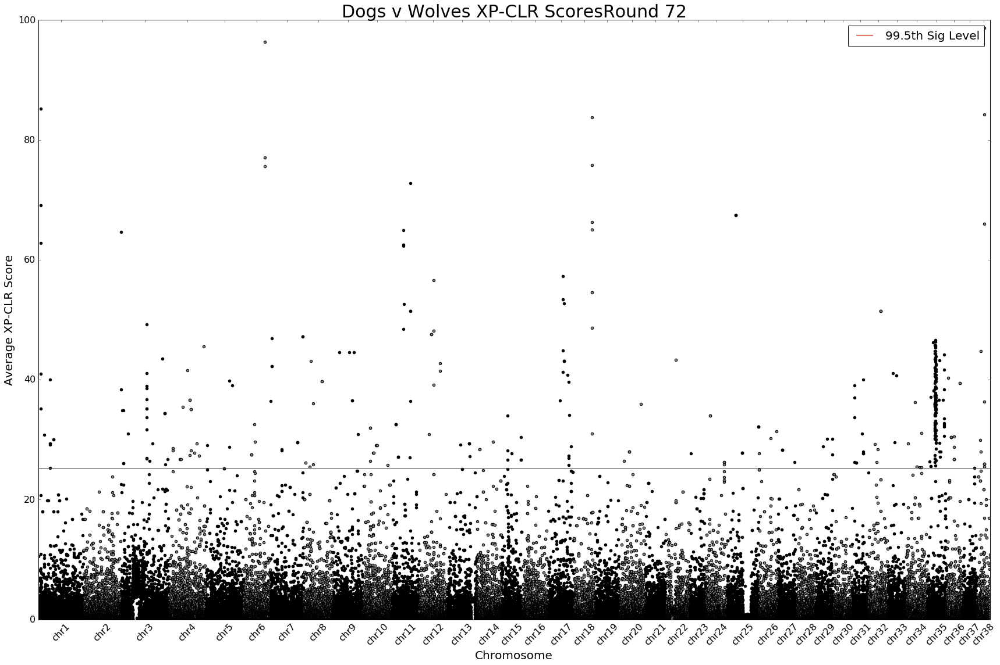

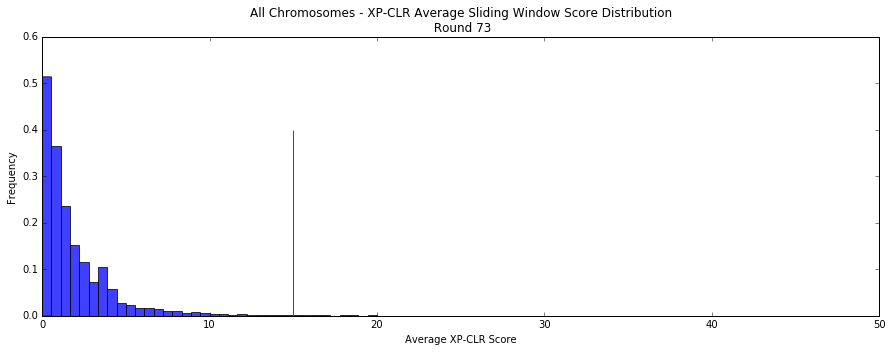

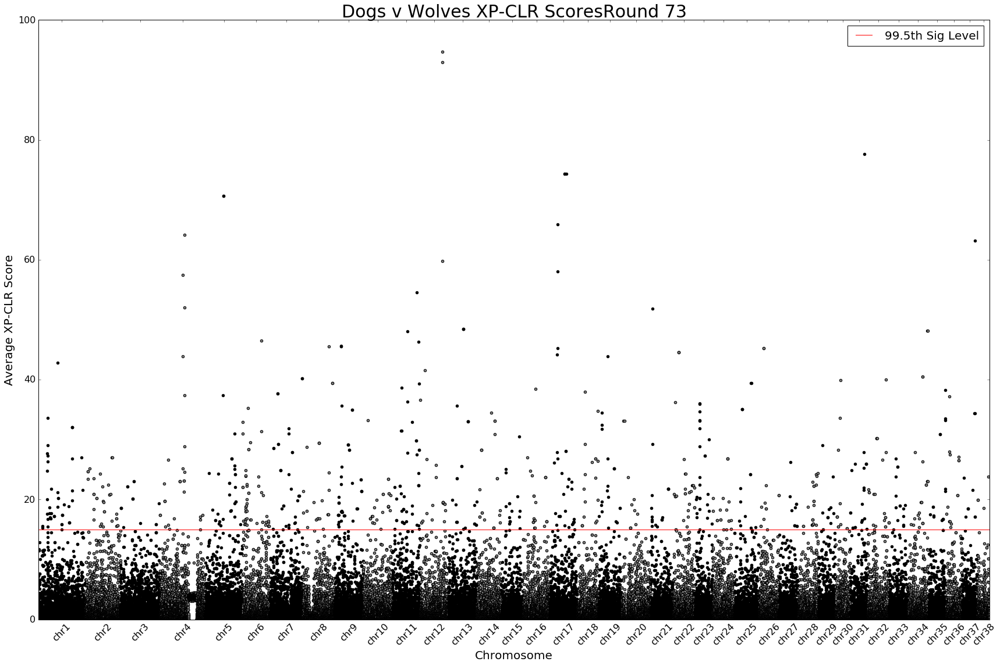

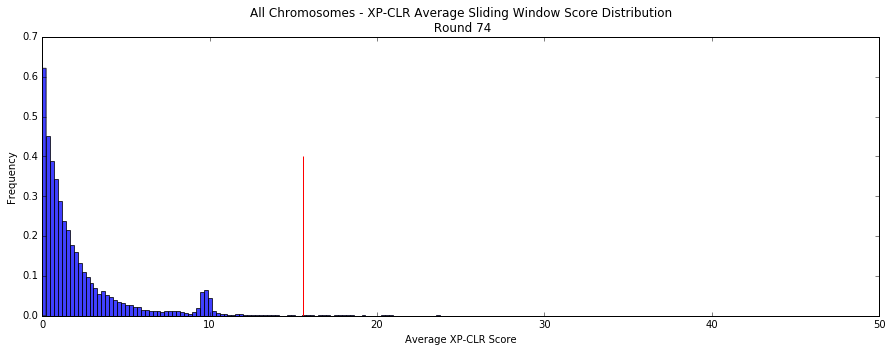

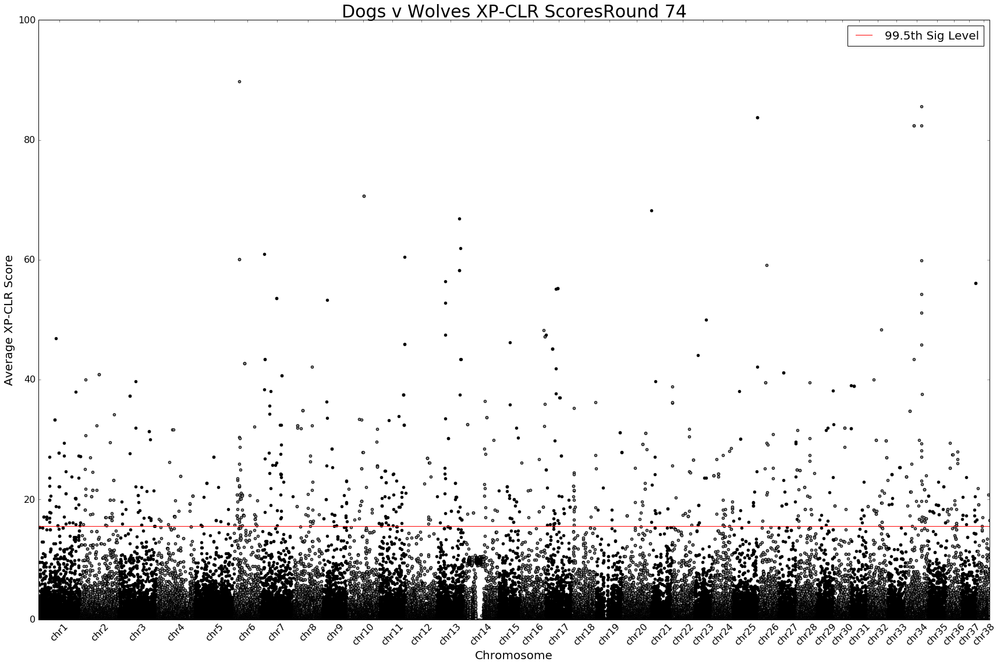

In [10]:
maxCount = 75
for index in range(0,maxCount):
    print('Processing file #%i' % (index))
    #read in chromosome average files === saves time
    inFile = open(resultsDir + '25kbSlidingWindowAverages_' + str(index) + '_' + subDir + '_XP-CLR_' + gridType + '.txt','r')
    sliding_window_coord_dict, chroms, count = {}, [], 0
    slideData, noDataCount = [], 0

    for line in inFile:
        if 'Average' in line: #skips header
            continue
        line=line.rstrip().split('\t')
        chrom=line[0]   
        if chrom not in chroms:
            chroms.append(chrom)
            sliding_window_coord_dict[chrom] = []
        chrom,start,end,windowcount,mean,median=line[0],int(line[1]),int(line[2]),int(line[3]),line[4],(line[5])
        sliding_window_coord_dict[chrom].append([chrom,start,end,windowcount,mean,median])
        #Remove windows that have 'na' as the mean (because there were no windows with snp/xpclr data there)
        if 'na' in line[4]:
            noDataCount += 1
            continue
        chrom,start,end,windowcount,mean,median=line[0],int(line[1]),int(line[2]),int(line[3]),float(line[4]),float(line[5])
        slideData.append([chrom,start,end,windowcount,mean,median])
        count += 1
    print('%i sliding windows had no data and were therefore ignored...' % noDataCount)
    print('%i windows remain for analysis and determination of significance thresholds\n' % len(slideData))

    #PROCESSING 
    #Filter out windows that do not have at least N grids () 
    filteredWindows = slide_filter_windows(slideData)
    #Calculate significance threshold (for now based on percentiles)
    df, pct99,pct995,pct999 = slide_basic_stats(filteredWindows)
    sigThreshold = pct99 #********CHANGE HERE IF YOU WANT TO ALTER THE SIGNIFICANCE THRESHOLD

    #plot histogram of sliding window averages
    plotFile = resultsDir + '/plots/' + short_windowSize + 'kbSlidingWindowAverages_' + str(index) + '_Histograms_' + subDir + '_XP-CLR_' + gridType + '.png'
    draw_slide_hist(df, plotFile, pct99,index)
    #Draw Manhattan plot of sliding window averages
    plotFile = resultsDir + '/plots/' + short_windowSize + 'kbSlidingWindowAverages_' + str(index) + '_ManhattanPlot_' + subDir + '_XP-CLR_' + gridType + '.png'
    slide_draw_Manhattan_Plot(slideData,plotFile,sigThreshold,index)

    #Find significant windows above 99.5th percentile 
    sigHits = slide_find_sig_windows(sigThreshold, filteredWindows)
    #Merge significanit windows above 99.5th percentile
    mergedWindows = slide_merge_sig_windows(sigHits)
    #Now identifying significant windows that are at least 3 windows wide
    merged3Windows = slide_filter_merged_windows(mergedWindows,index)


In [11]:
total_filteredWindows = []

for index in range(0,maxCount):
    print('\nProcessing file #%i' % (index))
    #read in chromosome average files === saves time
    inFile = open(resultsDir + '25kbSlidingWindowAverages_' + str(index) + '_' + subDir + '_XP-CLR_' + gridType + '.txt','r')
    sliding_window_coord_dict, chroms, count = {}, [], 0
    slideData, noDataCount = [], 0

    for line in inFile:
        if 'Average' in line: #skips header
            continue
        line=line.rstrip().split('\t')
        chrom=line[0]   
        if chrom not in chroms:
            chroms.append(chrom)
            sliding_window_coord_dict[chrom] = []
        chrom,start,end,windowcount,mean,median=line[0],int(line[1]),int(line[2]),int(line[3]),line[4],(line[5])
        sliding_window_coord_dict[chrom].append([chrom,start,end,windowcount,mean,median])
        #Remove windows that have 'na' as the mean (because there were no windows with snp/xpclr data there)
        if 'na' in line[4]:
            noDataCount += 1
            continue
        chrom,start,end,windowcount,mean,median=line[0],int(line[1]),int(line[2]),int(line[3]),float(line[4]),float(line[5])
        slideData.append([chrom,start,end,windowcount,mean,median])
        count += 1
    print('%i sliding windows had no data and were therefore ignored...' % noDataCount)
    print('%i windows remain for analysis and determination of significance thresholds\n' % len(slideData))

    #PROCESSING 
    #Filter out windows that do not have at least N grids () 
    filteredWindows = slide_filter_windows(slideData)
    total_filteredWindows = total_filteredWindows + filteredWindows

#ACROSS ALL    
#Calculate significance threshold (for now based on percentiles)
df, pct99,pct995,pct999 = slide_basic_stats(total_filteredWindows)
sigThreshold = pct99 #********CHANGE HERE IF YOU WANT TO ALTER THE SIGNIFICANCE THRESHOLD




Processing file #0
153982 sliding windows had no data and were therefore ignored...
66354 windows remain for analysis and determination of significance thresholds

66354 sliding windows remain with at least five grids found from XP-CLR

Processing file #1
153746 sliding windows had no data and were therefore ignored...
66590 windows remain for analysis and determination of significance thresholds

66590 sliding windows remain with at least five grids found from XP-CLR

Processing file #2
154814 sliding windows had no data and were therefore ignored...
65522 windows remain for analysis and determination of significance thresholds

65522 sliding windows remain with at least five grids found from XP-CLR

Processing file #3
152073 sliding windows had no data and were therefore ignored...
68263 windows remain for analysis and determination of significance thresholds

68263 sliding windows remain with at least five grids found from XP-CLR

Processing file #4
153176 sliding windows had no da

153586 sliding windows had no data and were therefore ignored...
66750 windows remain for analysis and determination of significance thresholds

66750 sliding windows remain with at least five grids found from XP-CLR

Processing file #36
153133 sliding windows had no data and were therefore ignored...
67203 windows remain for analysis and determination of significance thresholds

67203 sliding windows remain with at least five grids found from XP-CLR

Processing file #37
153414 sliding windows had no data and were therefore ignored...
66922 windows remain for analysis and determination of significance thresholds

66922 sliding windows remain with at least five grids found from XP-CLR

Processing file #38
153542 sliding windows had no data and were therefore ignored...
66794 windows remain for analysis and determination of significance thresholds

66794 sliding windows remain with at least five grids found from XP-CLR

Processing file #39
154894 sliding windows had no data and were ther

153609 sliding windows had no data and were therefore ignored...
66727 windows remain for analysis and determination of significance thresholds

66727 sliding windows remain with at least five grids found from XP-CLR

Processing file #71
153072 sliding windows had no data and were therefore ignored...
67264 windows remain for analysis and determination of significance thresholds

67264 sliding windows remain with at least five grids found from XP-CLR

Processing file #72
153264 sliding windows had no data and were therefore ignored...
67072 windows remain for analysis and determination of significance thresholds

67072 sliding windows remain with at least five grids found from XP-CLR

Processing file #73
153893 sliding windows had no data and were therefore ignored...
66443 windows remain for analysis and determination of significance thresholds

66443 sliding windows remain with at least five grids found from XP-CLR

Processing file #74
153336 sliding windows had no data and were ther

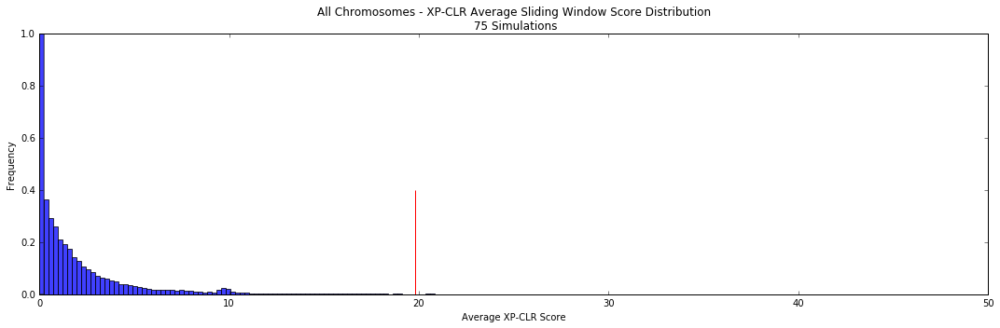

In [29]:
#Plot histogram for TOTAL (75 simulation) STATISTICS
plotFile = resultsDir + '/plots/' + short_windowSize + 'kbSlidingWindowAverages_' + 'TotalSimulationSet' + '_Histograms_' + subDir + '_XP-CLR_' + gridType + '.png'
fig = plt.figure(figsize=(15, 5)) #Set up subplots for below distributions
ax = fig.add_subplot(111)
df['Average_XP-CLR_Score'].plot(kind='hist', bins=500,xlim=(0,50),ylim=(0,1),alpha=0.75, normed = True)
ax.set_xlabel('Average XP-CLR Score')
ax.set_title('All Chromosomes - XP-CLR Average Sliding Window Score Distribution\n 75 Simulations')
ax.vlines(x=pct99,ymin=0,ymax=0.4, lw=1,color="red")
plt.tight_layout()
plt.savefig(plotFile) #Saving plots"""

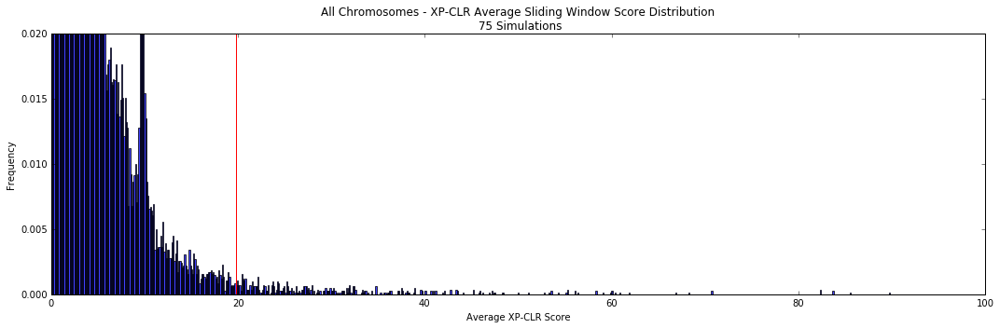

In [26]:
#Plot histogram for TOTAL (75 simulation) STATISTICS
plotFile = resultsDir + '/plots/Zoomed_' + short_windowSize + 'kbSlidingWindowAverages_' + 'TotalSimulationSet' + '_Histograms_' + subDir + '_XP-CLR_' + gridType + '.png'
fig = plt.figure(figsize=(15, 5)) #Set up subplots for below distributions
ax = fig.add_subplot(111)
df['Average_XP-CLR_Score'].plot(kind='hist', bins=1000,alpha=0.75, normed = True)
ax.set_xlabel('Average XP-CLR Score')
ax.set_title('All Chromosomes - XP-CLR Average Sliding Window Score Distribution\n 75 Simulations')
ax.vlines(x=pct99,ymin=0,ymax=0.4, lw=1,color="red")
#Yaxis
ax.set_xlim([0, 100])
ax.set_ylim([0, 0.02])
plt.tight_layout()
plt.savefig(plotFile) #Saving plots"""

#Calculating basic stats
Median XP-CLR Score is 1.198
Mean XP-CLR Score is  2.3527492822349045
Max XP-CLR Score is  423.32
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  19.78
99.5th percentile of XP-CLR scores ==  27.164
99.9th percentile of XP-CLR scores ==  46.329378

In [ ]:
#Calculating basic stats
Median XP-CLR Score is 2.093
Mean XP-CLR Score is  3.737219217906136
Max XP-CLR Score is  126.819
##SIGNIFICANCE CUT-OFFS
99th percentile of XP-CLR scores ==  28.86172
99.5th percentile of XP-CLR scores ==  39.86381
99.9th percentile of XP-CLR scores ==  72.39647